<h1><center>Laboratorio 2: OOP con Imágenes 📷</center></h1>

<center><strong>MDS7202: Laboratorio de Programación Científica para Ciencia de Datos - Primavera 2025</strong></center>

### Cuerpo Docente:

- Profesores: Diego Cortez, Gabriel Iturra
- Auxiliares: Melanie Peña, Valentina Rojas
- Ayudantes: Nicolás Cabello, Cristopher Urbina

### Equipo: **SUPER IMPORTANTE - notebooks sin nombre no serán revisados**

- Nombre de alumno 1: Josefa Anselmo.
- Nombre de alumno 2: Tamara Carrasco.


### **Link de repositorio de GitHub:** [Repositorio TamoJosha](https://github.com/Tamaracarrasco/TamoJosha-Lab-de-Prog-MDS-Prim2025)

## Reglas:

- **Grupos de 2 personas**
- Fecha de entrega: Entregas Martes a las 23:59.
- Instrucciones del lab el viernes a las 16:15 en formato online. Asistencia no es obligatoria, pero se recomienda **fuertemente** asistir.
- <u>Prohibidas las copias</u>. Cualquier intento de copia será debidamente penalizado con el reglamento de la escuela.
- Tienen que subir el laboratorio a u-cursos y a su repositorio de github. Labs que no estén en u-cursos no serán revisados. Recuerden que el repositorio también tiene nota.
- Cualquier duda fuera del horario de clases al foro. Mensajes al equipo docente serán respondidos por este medio.
- Pueden usar cualquier material del curso que estimen conveniente.

### Temas a tratar:

- Programación Orientada a Objetos.
- Programación Funcional.
- `Numpy` para manejo de datos en arreglos/tensores.




### Objetivos principales del laboratorio

- Aplicar los paradigmas y buenas prácticas de programación vistas hasta este momento.
- Comprender y aprovechar las ventajas que nos ofrece la liberia `numpy` con respecto a trabajar en Python 'puro'.
- Visualizar aplicaciones de filtros de imágenes sin el uso de librerías.
- Verificar que el uso indiscriminado de `for` puede afectar en la eficiencia en al procesar datos masivos.


El laboratorio deberá ser desarrollado **sin el uso indiscriminado de iteradores nativos de python (aka "for", "while")**. La idea es que aprendan a exprimir al máximo las funciones optimizadas que nos entrega `numpy`, las cuales vale mencionar, son bastante más eficientes que los iteradores nativos sobre arreglos.

El lab estará basado en algunos conceptos básicos de procesamiento de imágenes, por lo que te iremos guiando, paso a paso por cada uno de los tópicos a desarrollar.

## Descripción del laboratorio.

En Data Science son múltiples las aplicaciones que exigen el uso exhaustivo de listas de varias dimensiones. Estas entidad reciben formalmente el nombre de **arreglos o tensores**.

Pensemos en que queremos almacenar objetos en un casillero común y corriente: podemos pensar que este puede ser representado por una matriz de dos dimensiones: alto y ancho. ¿Que sucederá si este casillero nos queda pequeño y queremos guardar más información del mismo tipo?: La solución es simple es agregar otro casillero. Esto puede ser pensado como el aumento de la dimensión de nuestro objeto, pasando a ser ahora (alto, ancho, id casillero). Esto no es otra cosa que un **tensor de 3 dimensiones**.

<br>
<center>
<img src="https://i.imgur.com/HRiF5qA.png" width=600 height=600 />
</center>
<br>

### ¿Bueno y que tiene que ver todo esto con las imágenes?

Una imagen es una representación visual de una matriz que contiene de números que describen intensidades de color (llamados píxeles). Esto visto desde la perspectiva de una imagen en blanco y negro, vendria siendo una matriz que reune las diferentes intensidades de los pixeles desde 0 a 255.

<br>
<center>
<img src="https://miro.medium.com/max/1386/1*bV7S0zACdidh11ikjYpLpQ.png" width=500 height=500 alt="Representación de una imagen" />
</center>
<br>

Cuando las imágenes poseen colores, las imágenes vendrían siendo "sin querer queriendo", una bella representación de lo que es un tensor: estas pueden ser representadas por un tensor de 3 dimensiones que les dan el *ancho, alto y el canal*, en donde son alojados los colores de la imagen.

<br>
<center>
<img src="https://miro.medium.com/max/2146/1*icINeO4H7UKe3NlU1fXqlA.jpeg" width=300 height=300 alt="Representación de una imagen" />
</center>
<br>

Como pueden ver, la imagen puede ser interpretada como un tensor de tres dimensiones(un ancho, un alto y la intensidad de cada color) en el a cada posición $(i,j)$ de la imagen, le asociaremos 3 intensidades de colores RGB (Rojo, Verde y Azul). Estas intensidades irán desde el $0$ al $255$. La combinación de estos 3 canales nos permitirá representar gran parte de los colores que encontramos en la naturaleza.

**Instalar paquetes: Si están usando conda**


In [ ]:
#import sys

#!conda install --yes --prefix {sys.prefix} pillow plotly imageio

**Instalar paquetes: Si están usando pip**


In [41]:
import sys

!{sys.executable} -m pip install pillow plotly imageio


[notice] A new release of pip is available: 25.0.1 -> 25.2
[notice] To update, run: C:\Users\senza\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip


**En caso de trabajar con colab:**

In [ ]:
#try:
    #from google.colab import drive

    #drive.mount("/content/drive")
    #path = ""
#except:
    #print('Ignorando conexión drive-colab')

In [ ]:
#conda update plotly

In [42]:
# En este lab usaremos adicionalmente pillow, una estupenda librería
# para manejar imágenes.
# https://pillow.readthedocs.io/en/stable/

from PIL import Image
import numpy as np
import plotly.express as px

if not hasattr(np, "bool"):
    np.bool = np.bool_

foto = np.array(Image.open("./images_lab/cobija.PNG").convert("RGB")) # Red Green Blue

# Solo para ejemplificar, usaremos plotly (NO USARLO EN LO QUE QUEDA DEL LAB).
# Pero en el restro del laboratorio, matplotlib debe ser usado

fig = px.imshow(foto)
fig.show()

Luego, llamando la variable donde alojamos el array podemos ver los valores que componen a esta imagen.

In [43]:
print(f'Número de dimensiones: {foto.ndim}')
print(f'Número de elementos por dimensión: {foto.shape}')

Número de dimensiones: 3
Número de elementos por dimensión: (470, 597, 3)


Finalmente visualizamos de forma aleatoria los pixeles de cada canal para mostrar sus intensidades.

In [44]:
print(f"Ejemplo de pixel (10, 200) en el canal 0 - Red: {foto[10, 200, 0]}")
print(f"Ejemplo de pixel (10, 200) en el canal 1- Green: {foto[10, 200, 1]}")
print(f"Ejemplo de pixel (10, 200) en el canal 2- Blue: {foto[10, 200, 2]}")

Ejemplo de pixel (10, 200) en el canal 0 - Red: 97
Ejemplo de pixel (10, 200) en el canal 1- Green: 70
Ejemplo de pixel (10, 200) en el canal 2- Blue: 48


Con lo anterior, suponiendo que la imagen del "gatito" tiene una altura igual a 600 y un ancho de 400, el tensor $G$ que representa a la imagen vendrá dado por $G[600, 400, 3]$.

### Videos

Luego, si queremos complejizar aún mas esto y queremos tener tensores que agrupen un conjunto de imágenes (de igual tamaño) tendremos lo siguiente:


<br>
<center>
<img src="https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcRk4BWrH_xi_blsx9Y32OTT8k80vI90udG-Yg&usqp=CAU" width=300 height=300 alt="Representación de una imagen" />
</center>
<br>

Este conjunto de imágenes nos generará la necesidad de producir una nueva dimensión, esto producto que las dimensiones son los espacios donde alojamos la información, por esto al conjunto de imágenes le agregaremos una dimensión que identifica cada una de las imágenes del conjunto, quedando representada por el tensor $G[0:n_d, 600, 400, 3]$. Por lo general, cuando tenemos imágenes con dimensionalidad 4 es porque se tratan de videos, o sea una secuencia de imágenes; el caso se complejiza aún más cuando agregamos sonido y esto se va a las pailas.

<blockquote>Dato:
La representación que posee cada una de las dimensiones puede cambiar dependiendo de la librería utilizada, en pytorch por ejemplo las dimensiones de una imagen vienen dadas por [batch, canales, alto, ancho] y no [batch, alto, ancho, canales] como en numpy.
</blockquote>


### ¿Ya, pero esto tiene aplicaciones más allá de guardar información en casilleros?

Para el caso de imágenes podemos encontrar múltiples aplicaciones con la manipulación de los tensores y operando matemáticamente con ellos. Algunas de las aplicaciones más conocidas (y que aplicaremos) son las siguientes:

- **Obtener el negativo de una imagen**: Consiste en obtener el color complementario de una imagen, para esto debemos restar la imagen con la máxima intensidad que podemos encontrar en una imagen (o sea 255).
    
    
- **Pasar a escala de grises una imagen**: Los valores RGB se convierten a escala de grises mediante la fórmula NTSC:

    $$ imagen\_gris = 0.299 * Rojo + 0.587 * Verde + 0.114 * Azul $$
    
    Esta fórmula representa la percepción relativa de la persona promedio del brillo de la luz roja, verde y azul.
    
    
- **Mejora de contraste**: Son múltiples las técnicas que nos permiten mejorar el contraste de una imagen, pero, una técnica simple para modificar los contrastes consta en obtener un factor de corrección llamado F en base al contraste deseado (C). Luego, es aplicado en la diferencia entre la imagen y 128. De esta forma obtenemos R, que es la imagen con la mejora de contraste deseada.

    $$ F=259*(C+255)/(255*(259-C)) $$
    $$ R=F*(img-128)+128 $$
  
  
- **Convolución**: Consiste en recorrer una imagen por cada uno de sus canales utilizando una matriz que lleva por nombre Kernel. El kernel, examinará los conjuntos de pixeles que recorre, aplicando una multiplicación de los valores circundantes ,y sumando todos los valores generados de este producto para generar un nuevo pixel en el tensor de salida.

![conv](https://media3.giphy.com/media/i4NjAwytgIRDW/giphy.gif "miracomorecorre")

---

# Desarrollo

En base a lo explicado y visto en clases, a continuación, deben construir cada uno de los programas solicitados en las actividades señaladas más abajo. Estás, deben ser desarrollados de forma grupal (**2 personas por grupo**) y, la solución no debe ser compartida con personas externas al grupo; si se detecta que dos grupos entregan el mismo trabajo, será considerado plagio y se tomaran medidas al respecto.

## 2. Creación de Clases y Funciones.

#### Importamos librerias utiles 😸

In [45]:
# Libreria Core del lab.
import numpy as np
from pathlib import Path

# Librerias para graficar
import matplotlib.pyplot as plt

# Nota: Utilizar solo matplot para este lab. NO USAR PLOTLY,
# ya que tiene problemas de compatibilidad con imagenes

# Funcionalidades dependientes del Sistema Operativo.
import os

# Librerias utiles para cargar y generar Gifs
import imageio
from PIL import Image
from scipy.signal import convolve2d

### 2.1. Carga de imagenes y visualización

Descomprima el archivo "images_lab.zip" en algún directorio de su computador o plataforma, observen las imágenes y clasifíquenlas a su gusto, para luego en un diccionario cargar y agrupar las diferentes imágenes (no cree mas de tres llaves).

Hecho esto, visualize dos imágenes y verifique la dimensionalidad de estas imágenes con el comando *.shape*. Comente la dimensionalidad de las imágenes.

### Carga de imagenes en diccionarios

Las siguientes celdas de código le permitirá cargar las imágenes que utilizaremos durante este laboratorio.

La primera celda implementa la función `from_jpg`, la cual, dado una ruta, carga una imágen:


In [54]:
def from_jpg(path):
    ruta = Path(path) # Esto se cambia -> ruta de la carpeta google drive
    image = np.array(Image.open(ruta), dtype='int')
    return image

La segunda celda carga las imágenes y las guarda en un diccionario.

In [55]:
images = {
    "gatitos": [
        from_jpg("./images_lab/gato1.jpg"),
        from_jpg("./images_lab/gato2.jpg"),
        from_jpg("./images_lab/gato4.jpg"),
    ],
    "Personas": [
        from_jpg("./images_lab/personas.jpg"),
        from_jpg("./images_lab/gurus.jpg"),
    ],
    "Monos_chinos": [from_jpg("./images_lab/monitos.jpg")],
}

### Plot de imagenes
A continuación, utilice la función `def show(imagen)` (definida más abajo) para explorar las imágenes cargadas en la celda anterior.

**Respuesta Esperada**:

In [49]:
def show(imagen):
    plt.imshow(imagen)
    plt.show()
    x, y, z = imagen.shape
    print(f'Dimensiones de la imagen: {x}x{y} (Alto x Ancho)')

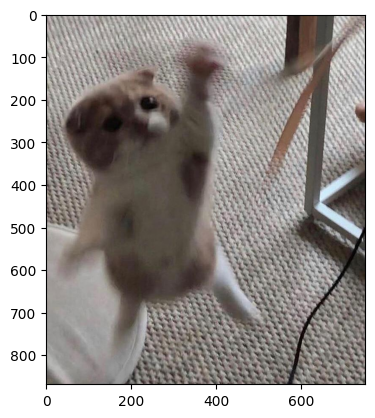

Dimensiones de la imagen: 869x750 (Alto x Ancho)


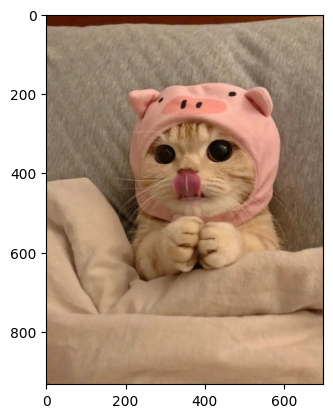

Dimensiones de la imagen: 933x700 (Alto x Ancho)


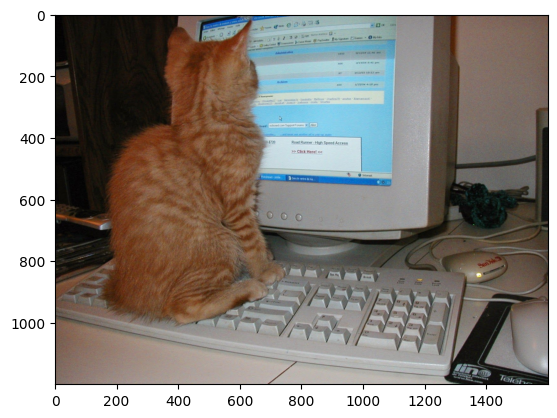

Dimensiones de la imagen: 1200x1600 (Alto x Ancho)


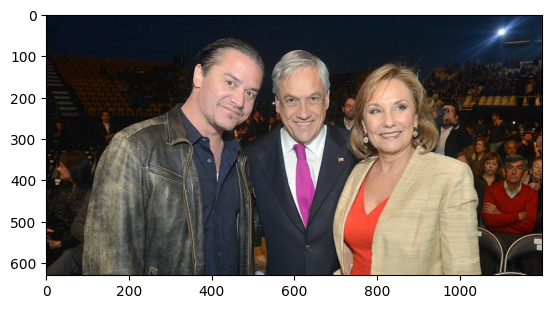

Dimensiones de la imagen: 630x1200 (Alto x Ancho)


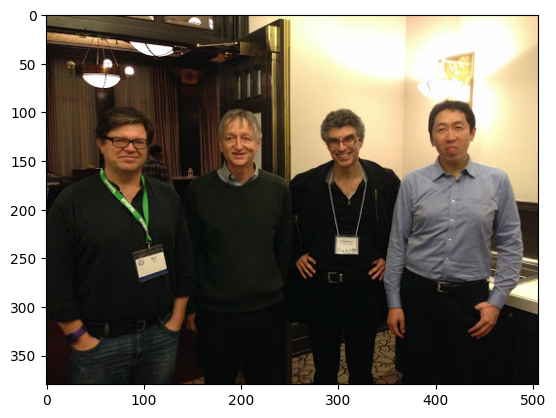

Dimensiones de la imagen: 380x506 (Alto x Ancho)


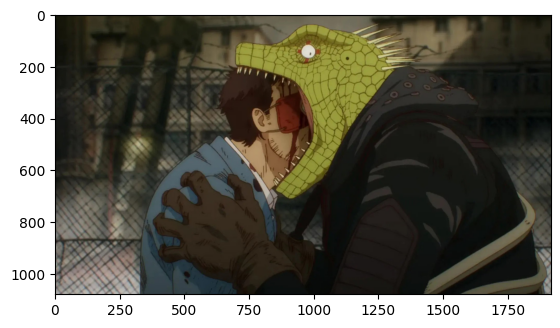

Dimensiones de la imagen: 1079x1917 (Alto x Ancho)


In [50]:
show(images['gatitos'][0])
# usar show para mostrar las otras imágenes...

show(images['gatitos'][1])

show(images['gatitos'][2])

show(images['Personas'][0])

show(images['Personas'][1])

show(images['Monos_chinos'][0])

### 2.2 Clase imagenes [2 puntos].

Ahora que sabemos cómo plotear y cargar una imagen, cree una clase llamada "Imagen" la que cumpla las siguientes características:

- [X] Un constructor que tome como argumento una imagen y que lo guarde como un atributo. `__init__` debe comprobar que la imagen es un arreglo de numpy (con `isinstance`) y adicionalmente que este tiene 3 dimensiones. En caso contrario, debe levantar excepciones con mensajes correspondientes al error detectado (ustedes definen el mensaje).
- [ ] Implemente el método `show()` que muestre la imagen usando la función `plt.show()`.
- [ ] Implemente el método `info()` que retorna un string con las dimensiones de la imagen.
- [ ] Sobrecargue el método mágico `__mul__`, `__add__` y `__sub__` para realizar operaciones matemáticas entre el objeto y arrays, int o floats. Realice la función pensando que la operación se puede aplicar tanto para izquierda y derecha. Como estamos trabajando con imágenes los outputs deben ser enteros, por esto se le aconseja utilizar `.astype(int)` para transformar los arrays de salida a un formato legible por matplotlib.
- [ ] Es importante que para las operaciones `__add__` y `__sub__` implementen una saturación de las imágenes. Es decir, la suma o resta deben dar como valor máximo 255 y/o como valor mínimos mayores o iguales a 0.
- [ ] Para el caso de `__mul__` deben implementar un método que nos permita saturar las imágenes (es decir que los valores del array no sobrepasen 255) y también no nos permita obtener valores inferiores a cero.

Implementadas los métodos, compruebe que la funcionalidad es la correcta mediante la ejecución de los asserts incluidos un par de celdas más abajo.

> **Notas:**
- Pueden reutilizar el código implementado en las celdas anteriores para implementar los métodos `show` e `info` . Sin embargo, No invoquen directamente esas funciones.
- La idea es que la imagen contenida en la clase sea inmutable, por ende, todos los metodos que modifiquen la imagen contenida en el objeto deberan retornar un nuevo objeto de la clase `Imagen` que contenga la imagen modificada.

In [56]:
class Imagen:
    """Clase contenedora de imágenes"""

    def __init__(self, img):
        if isinstance(img, np.ndarray):
            if img.ndim != 3:
                raise ("El argumento debe ser un arreglo de numpy de solo 3 dimensiones")
            if img.shape[-1] != 3:
                raise (
                    "El argumento debe ser un arreglo de numpy de solo 3 dimensiones "
                    "tal que la última dimensión solo tiene 3 canales"
                )
            self.imagen = img
        else:
            raise TypeError(
                "Debes entregar un arreglo de numpy como argumento del constructor de "
                "Imagen"
            )

    def show(self):
        """Muestra la imágen contenida en el objeto.
        Su funcionalidad debe ser igual a la de la función mostrar_imagen.
        """
        plt.imshow(self.imagen)
        plt.axis('off')  # Con esto podemos ocultar los ejes para ver mejor la imagen
        plt.show()

    def info(self):
        """ Imprime las características de la imagen cargada: Alto y ancho.
        """
        x,y,z = self.imagen.shape
        print(f"Dimensiones de la imagen (Alto x Ancho) : {x} x {y} ")

    def __add__(self, other):
        """Redefine la operación + entre imagen y escalar.

        # Idea, usar indexado condicial (similar a los filtros de pandas).
        # Sumar y luego que en cada pixel mayor a 255 sea asignado el máximo.
        # Ver los tests para mas información.

        Parameters
        ----------
        other : Union[int, float, np.ndarray]
            Escalar o arreglo que será sumado a cada pixel de la imagen
        """
        
        base = self.imagen.astype(np.float32) # Convertimos a float para evitar overflow
        arr = np.asarray(other, dtype=np.float32) # Convertimos a float para evitar overflow
        out = np.clip(base + arr, 0, 255).astype(int) # Sumamos y limitamos los valores entre 0 y 255

        return Imagen(out)

        # Esta la mofifique por eso de que no deberiamos usar los if, for, while, etc
        # Hay que asegurar que other sea int, float o np.ndarray

        #if isinstance(other, (int, float, np.ndarray)):

         #   new_temp_image = self.imagen + other 

          #  final_image = np.clip(new_temp_image, 0, 255).astype(int)
           # return Imagen(final_image)

    def __radd__(self, other):
        """Operación conmutativa de __add__.

        Hint: debería llamar a __add__...

        Parameters
        ----------
        other : Union[int, float, np.ndarray]
            Escalar o arreglo que será sumado a cada pixel de la imagen
        """
        return self.__add__(other)

    def __sub__(self, other):
        """Redefine la operación + entre imagen y escalar.

        # Idea, usar indexado condicial (similar a los filtros de pandas).
        # Restar y luego que en cada pixel mayor a 255 sea asignado el máximo.
        # Caso similar para valores menores a 0, donde debera asignar el minimo a esos pixeles
        # Ver los tests para mas información.

        Parameters
        ----------
        other : Union[int, float, np.ndarray]
            Escalar o arreglo que será sumado a cada pixel de la imagen
        """

        base = self.imagen.astype(np.float32) # Convertimos a float para evitar overflow
        arr = np.asarray(other, dtype = np.float32) # Convertimos a float para evitar overflow
        out = np.clip(base - arr, 0, 255).astype(int)

        return Imagen(out)

         # Esta la mofifique por eso de que no deberiamos usar los if, for, while, etc
        #if isinstance(other, (int, float, np.ndarray)):

         #   temp = self.imagen - other
          #  final_image = np.clip(temp, 0, 255).astype(int)
           # return Imagen(final_image)
        #else: 
         #   raise TypeError("argumento tiene que ser int, float o np.ndarray")

    def __rsub__(self, other):
        """Operación conmutativa de __sub__.

        Parameters
        ----------
        other : Union[int, float, np.ndarray]
            Escalar o arreglo que será sumado a cada pixel de la imagen
        """
        arr = np.asarray(other, dtype = np.float32) # Convertimos a float para evitar overflow
        base = self.imagen.astype(np.float32) # Convertimos a float para evitar overflow
        out = np.clip(arr - base, 0, 255).astype(int) # Restamos y limitamos los valores entre 0 y 255

        return Imagen(out)

         # Esta la mofifique por eso de que no deberiamos usar los if, for, while, etc
       # if isinstance(other, (int, float, np.ndarray)):

        #    temp = other - self.imagen
         #   final_image = np.clip(temp, 0, 255).astype(int)
          #  return Imagen(final_image)
        #else: 
        #    raise TypeError("argumento tiene que ser int, float o np.ndarray")
        

    def __mul__(self, other):
        """Redefine la operación + entre imagen y escalar.

        # Idea, usar indexado condicial (similar a los filtros de pandas).
        # Sumar y luego que en cada pixel mayor a 255 sea asignado el máximo y
        # cada valor inferior a 0 debe ser 0.
        # Ver los tests para mas información.

        Parameters
        ----------
        other : Union[int, float, np.ndarray]
            Escalar o arreglo que será sumado a cada pixel de la imagen
        """

        base = self.imagen.astype(np.float32) # Convertimos a float para evitar overflow
        arr = np.asarray(other, dtype=np.float32) # Convertimos a float para evitar overflow
        out = np.clip(base * arr, 0, 255).astype(int) # Multiplicamos y limitamos los valores entre 0 y 255

        return Imagen(out)

        # Esta la mofifique por eso de que no deberiamos usar los if, for, while, etc
        #if isinstance(other, (int, float, np.ndarray)):

         #   temp = self.imagen * other
          #  final_image = np.clip(temp, 0, 255).astype(int)
            
           # return Imagen(final_image)

        #else: 
         #   raise TypeError("argumento tiene que ser int, float o np.ndarray")

    def __rmul__(self, other):
        """Operación conmutativa de __mul__.

        Hint: debería llamar a __mul__...

        Parameters
        ----------
        other : Union[int, float, np.ndarray]
            Escalar o arreglo que será sumado a cada pixel de la imagen
        """
        return self.__mul__(other)

**Resultados esperados:**

In [57]:
gatito = Imagen(images["gatitos"][1])
gurus = Imagen(images["Personas"][1])

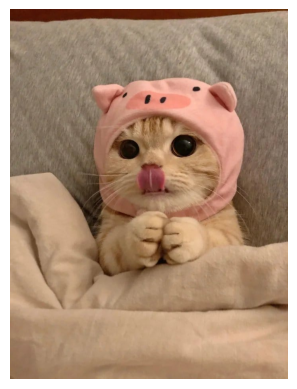

Dimensiones de la imagen (Alto x Ancho) : 933 x 700 


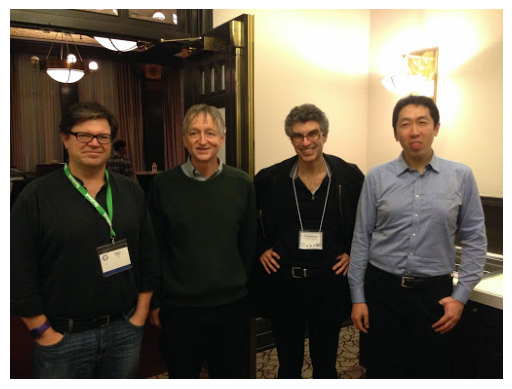

Dimensiones de la imagen (Alto x Ancho) : 380 x 506 


In [58]:
# Test show e info.
gatito.show()
gatito.info()

gurus.show()
gurus.info()

In [59]:
# Tests de los overload de operadores.

# Test __add__
# Idea del test: Todos los elementos de la imagen deben ser a lo más 255.

# Test __add__
assert np.max((gatito + 1000).imagen) == 255

# Test __radd__
assert np.max((1000 + gatito).imagen) == 255

# Test __sub__
assert np.min((gatito - (-1000)).imagen) == 255

# Test __sub__
assert np.max((gatito - 1000).imagen) == 0

# Test __rsub__
assert np.min((1000 - gatito ).imagen) == 255

# Test __mul__ (probar minimo)
assert np.max((-555555 * gatito).imagen) == 0

# Test __mul__ (probar maximo)
assert np.max((555555*gatito).imagen) == 255

# Test __rmul__ (probar minimo)
assert np.max((gatito*-555555).imagen) == 0

# Test __rmul__ (probar maximo)
assert np.max((gatito*555555).imagen) == 255


### 2.3 Clase de Procesamiento de Imagenes [2 puntos]

Ahora que comprenden las diferentes dimensiones que componen a una imagen (en la práctica), ahora realizaremos diferentes tareas de procesamiento de imágenes. Para esto, deben crear una clase llamada "`LibImagen`" que cumpla los siguientes requisitos:

- [ ] Pasar una imagen a escala de grises, para esto utilice la ecuación (1) expuesta en este mismo notebook.
- [ ] Obtener los canales R, G y B de forma individual.
- [ ] Crear una función que pase a negativo de la imagen alojada.
- [ ] Mejorar el contraste de una imagen.
- [ ] Realizar una convolución sobre la imagen.
- [ ] Documentar la clase creada y verificar la documentación con el comando help().


> **Nota 🗒️**: Todo método debe tomar una Imagen y retornar una nueva Imagen.

> **Nota 2**: El tipo de datos del arreglo de la imagen que generen o modifiquen debe ser "int". De lo contrario, puede no visualizarse correctamente.


In [63]:
class LibImagen():

    def to_negative(self, img_in):
        """Convierte imagen a negativo.

        Parameters
        ----------
        """
        img = img_in.imagen.astype(np.int32) # para evitar overflow
        neg = 255 - img

        """
        Returns
        -------
        """
        return Imagen(neg.astype(int))
        
        # Solo cambie los nombres de parámetros a los que decía el enunciado y no reutilicé la definición de arriba porque no salia que lo hicieramos :(

        #final_image = img_in.__rsub__(255) # la resta ya devuelve un nuevo objeto
        #return final_image


    def to_gray(self, img_in):
        """
        Transforma una imagen en RGB a la escala de grises.

        Parameters
        ----------
        """
        img = img_in.imagen.astype(np.float32) # para evitar overflow

        rojo = img[:, :, 0] # tiene dimension (alto, ancho) -> es un plano 2d
        verde = img[:, :, 1]
        azul = img[:, :, 2]

        gray = (0.299 * rojo + 0.587 * verde + 0.114 * azul).astype(int) # redefino en plano 2d
        gray = np.clip(gray, 0, 255) # aseguro que no haya valores fuera de rango
        gray3 = np.repeat(gray[..., None], 3, axis=2).astype(int) # lo convierto a 3 canales

        #  $$ imagen\_gris = 0.299 * Rojo + 0.587 * Verde + 0.114 * Azul $$

        """
        Returns
        -------
        """
        return Imagen(gray3)
        
        #img_array = img_in.imagen # hay q acceder a los canales rgb

        #rojo = img_array[:, :, 0] # tiene dimension (alto, ancho) -> es un plano 2d
        #verde = img_array[:, :, 1]
        #azul = img_array[:, :, 2]

        #gray_array = (0.299 * rojo + 0.587 * verde + 0.114 * azul).astype(int) # plano 2d

        #gray = np.stack([gray_array]*3, axis=-1)
        
        #return Imagen(gray)


    def get_channel(self, img_in, channel):
        """Obtiene un canal de un color seteando el resto de los canales en 0.

        Parameters
        ----------
        """
        img = img_in.imagen.astype(np.int32) # para evitar overflow

        idx = {'r':0, 'g':1, 'b':2}[channel.lower()] # Así puedo mapear el indice del canal que quiero

        out = np.zeros_like(img, dtype=np.int32)
        out[..., idx] = img[..., idx]

        """
        Returns
        -------
        """
        return Imagen(out.astype(int))
        

    def set_contrast(self, img_in, C):
        """Mejora el contraste de una imagen.

        Parameters
        ----------
        """
        img = img_in.imagen.astype(np.float32) # para evitar overflow

        F = (259*(C + 255)) / (255*(259 - C)) # Esta fórmula la saqué del enunciado
        
        R = np.clip(F * (img - 128) + 128, 0, 255).astype(int) # aseguro que no haya valores fuera de rango
        """
        Returns
        -------
        """
        return Imagen(R)


    def conv_channel(self, img_in, kernel):
        """
        Esta definición aplica una convolución de 2D de un kernel sobre cada canal RGB de la imagen.

        Parámetros:
        img _in : Imagen -> Este es el objeto Imagen que contiene la imagen a procesar en formato RGB (3 canales).
        kernel : ndarray -> Esta es una matriz de 2D de pesos que define el filtro de convolución ayudando a identificar bordes, suavizado, desenfoque, nitidez, etc.

        Returns:
        Imagen -> Obtenemos un objeto Imagen que contiene la imagen ya convolucionada resultante de aplicar el kernel a cada canal por separado. Esta salida
                 mantiene 3 canales y los valores se acotan entre 0 y 255. Además estos se convierten a numeros enteros entonces así nos aseguramos de que la 
                 visualización sea correcta.        
        """
        img = img_in.imagen
        img_out = []
        for i in range(img.shape[-1]):
            img_channel = convolve2d(img[:, :, i],
                                     kernel,
                                     mode="same", # para que la salida tenga el mismo tamaño que la entrada
                                     boundary="symm") # boundary symm para evitar bordes raros
            img_out.append(img_channel)
        new_image = np.stack(img_out, axis=2)
        new_image[new_image>255], new_image[new_image<0] = 255, 0
        return Imagen(new_image.astype(int))

In [64]:
help(LibImagen.conv_channel)

Help on function conv_channel in module __main__:

conv_channel(self, img_in, kernel)
    Esta definición aplica una convolución de 2D de un kernel sobre cada canal RGB de la imagen.
    
    Parámetros:
    img _in : Imagen -> Este es el objeto Imagen que contiene la imagen a procesar en formato RGB (3 canales).
    kernel : ndarray -> Esta es una matriz de 2D de pesos que define el filtro de convolución ayudando a identificar bordes, suavizado, desenfoque, nitidez, etc.
    
    Returns:
    Imagen -> Obtenemos un objeto Imagen que contiene la imagen ya convolucionada resultante de aplicar el kernel a cada canal por separado. Esta salida
             mantiene 3 canales y los valores se acotan entre 0 y 255. Además estos se convierten a numeros enteros entonces así nos aseguramos de que la 
             visualización sea correcta.



### 2.4 Probar [0,5 puntos]

**Respuesta Esperada**:

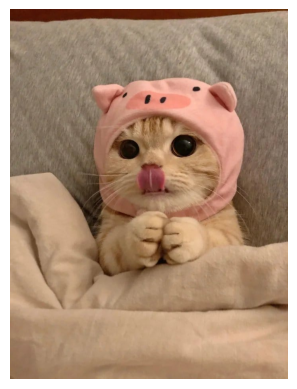

Negativo


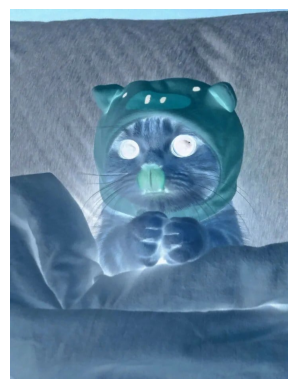

Grayscale


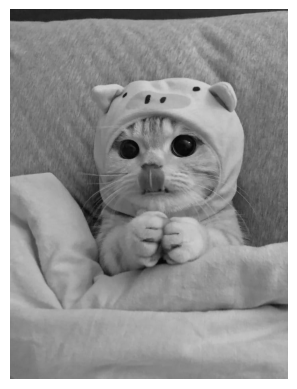

Selección de Canales


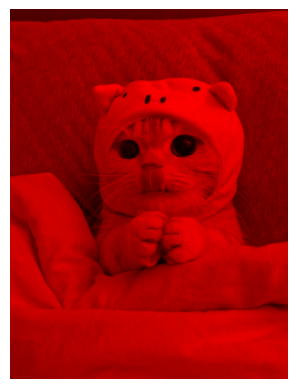

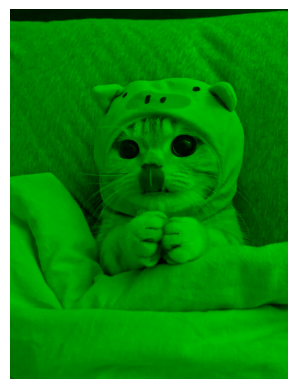

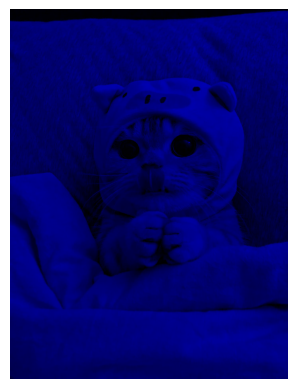

Mejora de Contraste


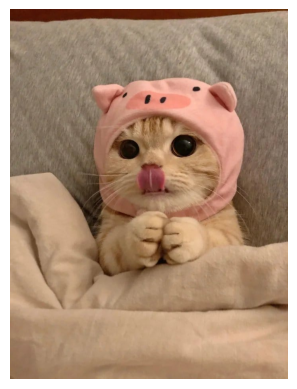

Convolución


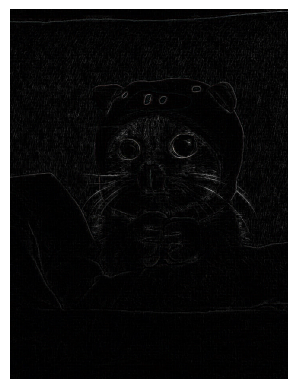

In [65]:
gatito = Imagen(images["gatitos"][1])

gatito.show()

lib = LibImagen()

print('Negativo')
lib.to_negative(gatito).show()

print('Grayscale')
lib.to_gray(gatito).show()

print('Selección de Canales')
lib.get_channel(gatito, "r").show()
lib.get_channel(gatito, "g").show()
lib.get_channel(gatito, "b").show()

print('Mejora de Contraste')
lib.set_contrast(gatito, 0).show()

print('Convolución')
kernel = np.array([[-1, -1,  -1],
                   [-1,  8,  -1],
                   [-1, -1,  -1]])

lib.conv_channel(gatito, kernel).show()

#### Implementar 5 Kernels y probarlos con las imagenes

Referencia:
https://en.wikipedia.org/wiki/Kernel_(image_processing)

Box blur


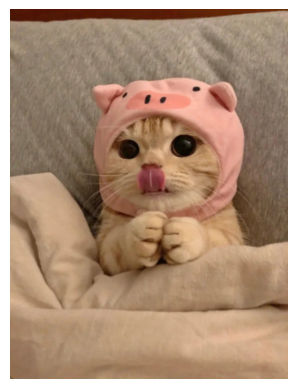

Gaussian blur 5x5


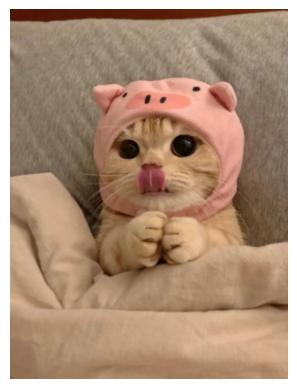

Sharpen 3x3


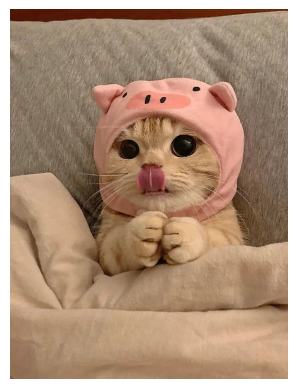

Gaussian blur 3x3


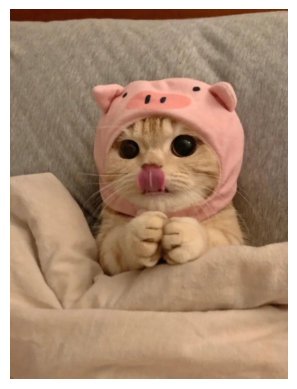

Unsharp mask 5x5


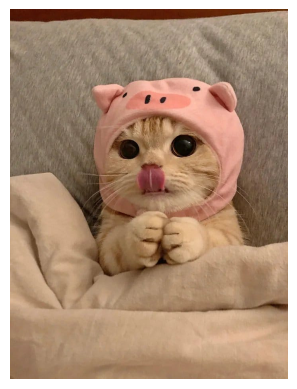

In [71]:
# Convolución
kernel_1 = np.ones((3, 3), dtype = float) / 9 # Este es un kernel box blur, es como un suavizado simple

kernel_2 = np.outer(np.array([1, 4, 6, 4, 1], dtype = float), np.array([1, 4, 6, 4, 1], dtype = float)) / 256 # Este es un kernel de desenfoque Gaussiano 5x5
                                                                                                                    # este se ve más natural que el box blur

kernel_3 = np.array([[0, -1, 0],
                     [-1, 5, -1],
                     [0, -1, 0]], dtype = float) # Este es un kernel "Afilado" 3x3 de realce de bordes y detalle finos,
                                                 # que es más simple que el Unsharp Mask 5x5.

kernel_4 = np.array([[1, 2, 1],
                     [2, 4, 2],
                     [1, 2, 1]], dtype=float) / 16 # Este es un kernel de desenfoque Gaussiano 3x3.
                                                   # que se diferencia del 5x5 en que es más pequeño y por lo tanto más rápido de computar, 
                                                   # pero menos efectivo para desenfoques fuertes

kernel_5 = np.array([[-1,  -4,  -6,  -4, -1],
                     [-4, -16, -24, -16, -4],
                     [-6, -24, 476, -24, -6], 
                     [-4, -16, -24, -16, -4],
                     [-1,  -4,  -6,  -4, -1]], dtype=float) / 256 # Este es un kernel de Unsharp Mask 5x5, 
                                                                  # que es un filtro de realce de bordes y detalles finos

print('Box blur')
lib.conv_channel(gatito, kernel_1).show()
print('Gaussian blur 5x5')
lib.conv_channel(gatito, kernel_2).show()
print('Sharpen 3x3')
lib.conv_channel(gatito, kernel_3).show()
print('Gaussian blur 3x3')
lib.conv_channel(gatito, kernel_4).show()
print('Unsharp mask 5x5')
lib.conv_channel(gatito, kernel_5).show()

**Comente:**

Para finalizar, comente que hace (o debería hacer) cada filtro convolucional al aplicarlas a su imagen de ejemplo.

```
1.- El kernel 'Box blur' es como un promedio uniforme de 9 vecinos. Suaviza la imagen reduciendo el "ruido" y texturas más finas, pero a la vez desenfoca bordes y detalles. Como es un kernel "normalizado", pues suma 1, no cambia el brillo global de la imagen pero sí reduce el contraste local y la varianza de intensidades. Lo que genera visualmente es como un efecto de bordes más "limpios" y menos "ruido" en la imágen.

2.- El kernel 'Gaussian blur 5x5' se asemeja al Box blur pero este es con pesos gaussianos, entoces el desenfoque que produce es más natural. Como es de 5x5, más grande por decir, el radio efectivo es mayor que cuando aplico uno de 3x3 y además suaviza más porque es mejor que el otro en la reducción de ruido y generando imágenes visiblemente más "finas", pero si "pierde" un poco más del detalle de los bordes (ese es como el trade-off aquí). De todos modos mantiene el brillo global por normalizaión. Como comentario extra este kernel es útil de utilizar antes de downsampling o para reducir aliasing en imágenes.

3.- El kernel 'Sharpen 3x3' ayuda con el realce de los bordes en las imágenes. Aumenta el contaste local al rededor de las transiciones, logrando una imágen visualmente más nítida. Eso sí, podría amplificar el ruido de la imágen y por los negativos al rededor del centro puede provocar overshoot/halos ligeros. Como aplicamos clipping para setear el rango en el kernel, podría ocurrir que zonas muy contrastadas se saturen.

4.- El kernel 'Gaussian blur 3x3' es la misma idea que el kernel Gaussian blur 5x5 pero este es "más pequeño" y por ende logra un suavizado leve con menor desenfoque, conservando mejor los contornos de las imágenes, lo que además implica un menor costo computacional. Este es útil para reparar pequeños defectos o ruido sin que se arruine mucho el detalle de la imagen. Al estar normalizado tampoco afecta en el brillo global de la imagen.

5.- El kernel 'Unsharp mask 5x5', a diferenica de los demás, implementa "acutancia" la cual se define como -> resultado ~ imagen + amount * (imagen - gaussiana 5x5(imagen)).
Este kernel realza bordes y tiene mayor alcance a los micro detalles debido a la matriz gaussiana 5x5. Lo malo es que puede amplificar ruido y generar halos en contornos fuertes como por ejemplo ocurre con los clipping seteados para el rango específico, entonces estos pueden aparecer en zonas de alto contraste (luces y sombras).
```



## 3. Secuencias y Detección de Movimiento


### 3.2. Secuencia de Imagenes [1,5 punto]


A continuación, deben programar una función que nos permite resaltar los objetos en movimientos de una secuencia de imágenes. Para esta parte del laboratorio, deberá utilizar las imágenes dispuestas en la carpeta `secuencia_plaza` del archivo zip subido a material docente.

Primero que todo, cargue la secuencia de imágenes que se encuentran en el directorio. Para esto, se recomienda utilizar el comando `os.listdir(dir)`, ya que este le facilitará la carga de un gran número de imágenes (pruebe el comando y vea que sucede).

In [72]:
path = "./secuencia_plaza/"
img_names = os.listdir(path)

imagenes = np.array(list(map(lambda img: np.array(Image.open(path + img)), img_names)))



![plaza se mueve](https://media0.giphy.com/media/ZAzlopoHETs5lZQ6EZ/giphy.gif "plaza")

Para realizar este ejercicio utilizaremos un método super básico para la eliminación de fondo. Para esto sigue la siguiente receta:
 1. Pase a escala de grises todas las imágenes secuenciales.
 2. Almacene en una variable la resta de las imágenes consecutivas.

   $$ imagen\_out = imagen(t) - imagen(t+1) $$

 3. Establezca un umbral para eliminar algunos artefactos. Pruebe con al menos 3 umbrales.

$$ imagen\_out = imagen\_out> Umbral $$

**Nota**: No es necesario que construya una clase para esta parte.

In [ ]:
def dect_mov(sec_img, umbral=30):
    
    imgs = sec_img.astype(np.float32) # Antes que nada y para evitar overflow, obligo a que la imagen sea un float32

    gray = imgs @ np.array([0.299, 0.587, 0.114], dtype=np.float32) # convierto las imágenes a escala de grises que era el paso 1

    diff = np.abs(np.diff(gray, axis=0)) # diferencias absolutas entre frames

    thr = np.ravel(np.array(umbral, ndmin=1, dtype=np.float32)) # umbral... hay que probar con 3
    mask = (diff[..., None] > thr) * 255 # máscara binaria

    out = mask.astype(int).squeeze(-1) # quito la última dimensión que es de 1 canal

    return out

### 3.3 Resultado

Ahora es tiempo de relajarse y ver si nuestro experimento logra resaltar los objetos en movimiento de esta polémica Plaza, para esto solo ejecute el siguiente Código y espere.

In [75]:
imageio.mimsave('plaza.gif', dect_mov(imagenes)) # Listo

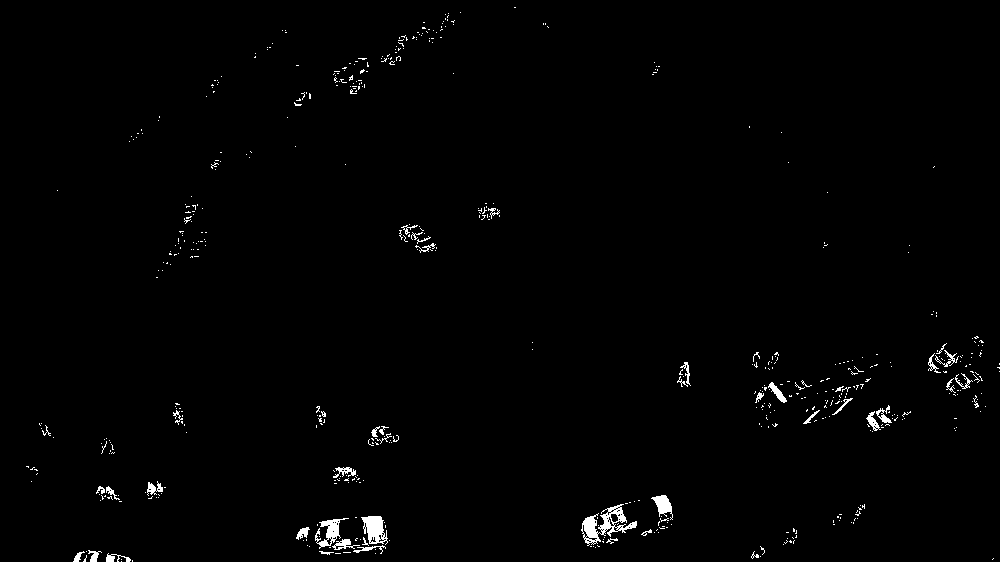

In [79]:
"""
Este código no venia en el Lab, lo busqué para comprobra que el putput resultara y parece que sí funciona.
Se puede prbar con distintos umbrales
"""

# 1) Genera máscaras (un solo umbral) y asegura tipo/forma adecuados
frames = dect_mov(imagenes, umbral=70).astype(np.uint8)   # (T-1, H, W)

# 2) Crea el GIF (ajusta "duration" = segundos por frame)
imageio.mimsave('plaza.gif', frames, duration=0.06, loop=0)  # ~16.7 fps

# 3) Muéstralo inline en el notebook
from IPython.display import Image as IPImage, display
display(IPImage(filename='plaza.gif'))


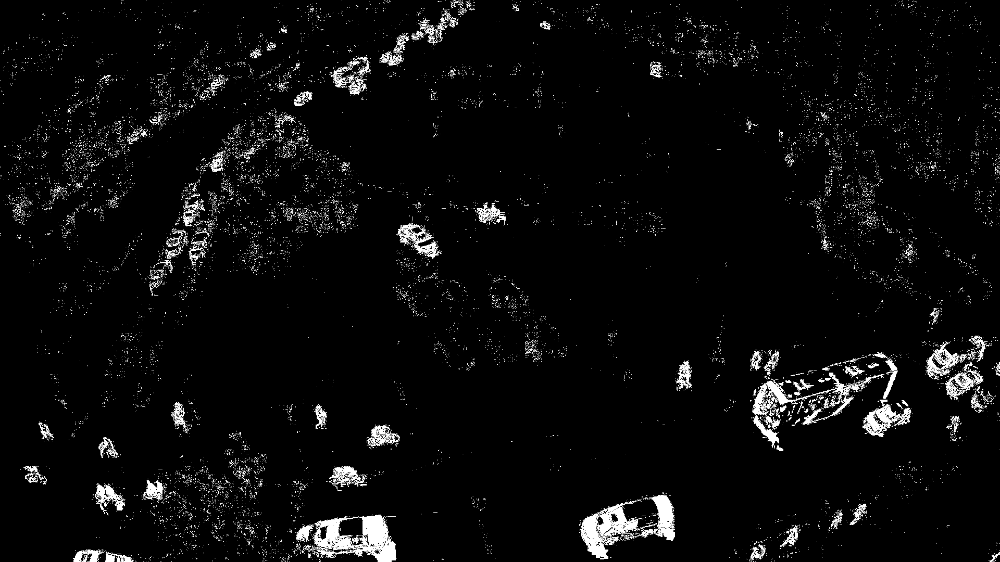

In [80]:
# 1) Genera máscaras (un solo umbral) y asegura tipo/forma adecuados
frames = dect_mov(imagenes, umbral=20).astype(np.uint8)   # (T-1, H, W)

# 2) Crea el GIF (ajusta "duration" = segundos por frame)
imageio.mimsave('plaza.gif', frames, duration=0.06, loop=0)  # ~16.7 fps

# 3) Muéstralo inline en el notebook
from IPython.display import Image as IPImage, display
display(IPImage(filename='plaza.gif'))

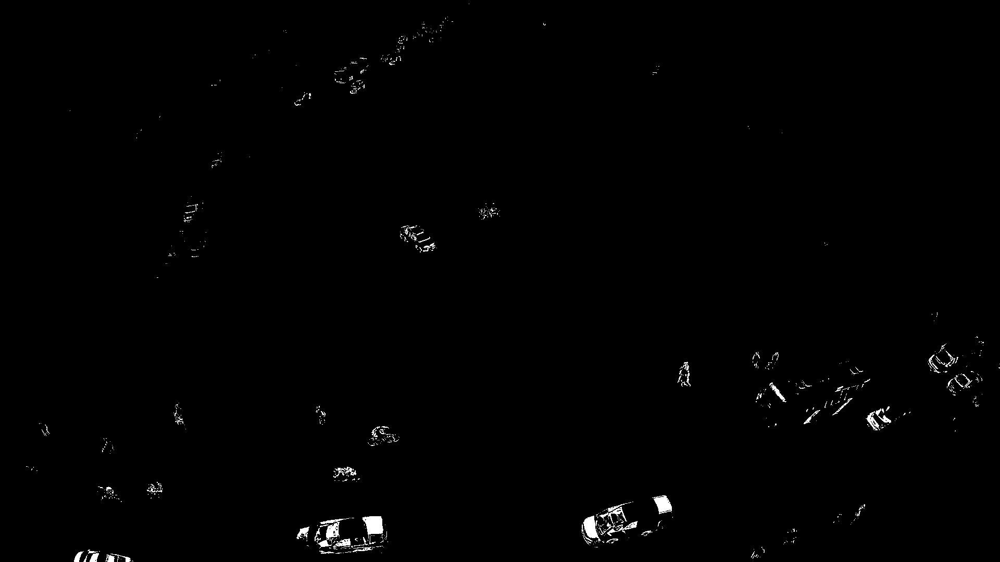

In [82]:
# 1) Genera máscaras (un solo umbral) y asegura tipo/forma adecuados
frames = dect_mov(imagenes, umbral=100).astype(np.uint8)   # (T-1, H, W)

# 2) Crea el GIF (ajusta "duration" = segundos por frame)
imageio.mimsave('plaza.gif', frames, duration=0.06, loop=0)  # ~16.7 fps

# 3) Muéstralo inline en el notebook
from IPython.display import Image as IPImage, display
display(IPImage(filename='plaza.gif'))

**Ejemplo de resultado esperado:**

![resultados](https://media3.giphy.com/media/SKV3bgUzHt0MLJTWW2/giphy.gif "res")

### Referencias lab 1.

- http://www.cs.cornell.edu/cv/SummerSchool/Introduction.pdf
- https://en.wikipedia.org/wiki/Tensor
- https://support.ptc.com/help/mathcad/es/index.html#page/PTC_Mathcad_Help/example_grayscale_and_color_in_images.html
- http://w3.unpocodetodo.info/canvas/negativo.php
- http://www.dfstudios.co.uk/articles/programming/image-programming-algorithms/image-processing-algorithms-part-5-contrast-adjustment/